In [1]:
import math
import time
import random
import datetime

import shap
import numpy as np
import pandas as pd
import xgboost as xgb
import seaborn as sns
import matplotlib.pyplot as plt
import category_encoders as ce

from xgboost import plot_importance
from xgboost.sklearn import XGBRegressor

from joblib import dump, load
from sklearn import preprocessing
from sklearn import linear_model
from sklearn.feature_selection import RFECV
from sklearn.feature_selection import SelectKBest
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import ShuffleSplit
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.model_selection import learning_curve
from sklearn.feature_selection import f_regression, mutual_info_regression
from sklearn.metrics import mean_squared_error,mean_absolute_error, r2_score

def read_data(path):
    '''读取数据
    '''
    cropland_area = pd.read_csv(path,engine='python',encoding="utf8")
    return cropland_area

def test_metrics(truth,pred):
    '''MAE、MSE、RMSE、决定系数
    '''
    print('----')
    print('Test_MAE: %.4f'%mean_absolute_error(truth,pred))
    print('Test_MSE: %.4f'%mean_squared_error(truth,pred))
    print('Test_RMSE: %.4f'%mean_squared_error(truth,pred,squared=False))
    print('Test_R2: %.4f'%r2_score(truth,pred))
    return mean_squared_error(truth,pred,squared=False),r2_score(truth,pred)
def train_metrics(truth,pred):
    '''MAE、MSE、RMSE、决定系数
    '''
    print('----')
    print('Train_MAE: %.4f'%mean_absolute_error(truth,pred))
    print('Train_MSE: %.4f'%mean_squared_error(truth,pred))
    print('Train_RMSE: %.4f'%mean_squared_error(truth,pred,squared=False))
    print('Train_R2: %.4f'%r2_score(truth,pred))
    return 
def model_result(est,X_train_val, X_test, y_train_val, y_test):

    # training
    y_train_pred = est.predict(X_train_val)
    train_metrics(y_train_val, y_train_pred)
    # test
    y_test_pred = est.predict(X_test)
    RMSE, R2 = test_metrics(y_test, y_test_pred)
    return RMSE, R2
def model_lineresult(est,model,year,X_train_val, X_test, y_train_val, y_test):
    # Evaluate model performance 
    date = datetime.datetime.now().strftime('%Y-%m-%d')
    # training
    y_train_pred = est.predict(X_train_val)
    # test
    y_test_pred = est.predict(X_test)
    print('{} {} {} 【Train_RMSE: {:.2f}, Train_R2: {:.2f}, Test_RMSE: {:.4f}, Test_R2: {:.2f}】'
          .format(date,year,model,np.sqrt(mean_squared_error(y_train_val, y_train_pred)),r2_score(y_train_val, y_train_pred),
          np.sqrt(mean_squared_error(y_test, y_test_pred)),r2_score(y_test, y_test_pred)))
    return np.sqrt(mean_squared_error(y_test, y_test_pred)),r2_score(y_test, y_test_pred)

def average_yield_of_N_years(data,N):
    '''It's a function that calculates the average yield for the previous N years of a given year, of each county.
    
    Paramaters
    ----------
    data:DF, Yield data
    N:int,Average yield of the past N years involved in the calculation
    
    Return
    ----------
    data
    '''
    for county in set(data['sta_con']):
        for year in range(2014,2022):
            yearlist = [i for i in range(year-N,year)]
            data.loc[(data['Year']==year) & (data['sta_con']==county),'average yield'] = data[(data['Year'].isin(yearlist)) & (data['sta_con']==county)]['yield(t/ha)'].mean()
    data = data.fillna(data.groupby(['Year','State']).transform('mean'))
    return data

In [5]:
def yield_predictor(data, test_year=[2020], N=2, experiment = 'NTP', croptype = 'soybean', model = ['XGBoost'], verbose = 0, 
                    tune_model = False, model_parameter=None, result = False, feature_importance = False,
                    fea_eng = False,seed = 99,save_model=False, save_model_dir='', result_dir = '',trend_n = 30,
                    importance_dir = '', feature_list = None, n_features = 200, metric_list = []):
    '''Yield predictor
    Parameters:
    
    '''
    print('seed:',seed, 'croptype:',croptype,' ','test_year:',test_year[0],' ',
          'experiment:',experiment,' ','training year:',N,' ','trend_n：',trend_n)
    # Encoding categry feature
    # one-hot encoding
    onehot_cols = ['State']
    new_onehot_cols = pd.get_dummies(data[onehot_cols]).columns.tolist()
    data.loc[:,new_onehot_cols] = pd.get_dummies(data[onehot_cols])
    # select features using features importance
    feature_name = feature_list.iloc[0:n_features]['feature'].tolist()
    feature_name = ['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30']+feature_name
    #print(feature_name)
    data = data[feature_name]
    # data = data.drop(onehot_cols,axis=1)
    # split train-validation and test data
    # testset
    data_test = data[data['Year'].isin(test_year)]
    # tra-val set
    data_train_val = data[data['Year'].isin([i for i in range(test_year[0]-N,test_year[0])])]
    # split input and output
    y_train_val = data_train_val['yield(t/ha)']
    y_test = data_test['yield(t/ha)']
    
    # Experimental setup
    # 1. no trend processing (NTP)
    # 2. Input year as a feature (IYF)
    # 3. Input average yield as a feature (IAYF)
    # 4. Input linear yield as a feature (ILYF)
    # 5. Global de-trending (GDT)
    if experiment == 'NTP': # NTP
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
    if experiment == 'IYF': # IYF
        X_train_val = data_train_val.drop(['sta_con','yield(t/ha)','State','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','yield(t/ha)','State','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
    if experiment == 'IAYF': # IAYF
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
    if experiment == 'ILYF':  # ILYF
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
    if experiment == 'GDT': # GDT
        # de-trend the yield using linear model
        yield_mean = data_train_val['yield(t/ha)'].mean()
        linear_m = linear_model.LinearRegression()
        
        data_train_val1 = data[data['Year'].isin([i for i in range(test_year[0]-trend_n,test_year[0])])]
        X99 = np.array(data_train_val1['Year']).reshape(-1,1)
        Y99 = np.array(data_train_val1['yield(t/ha)']).reshape(-1,1)

        linear_m.fit(X99, Y99)
        if linear_m.coef_[0,0]<0:
            yield_mean = data_train_val['yield(t/ha)'].max()
        print('The foluma of de-trend the yield: yield_new = yield - {:.3f}×year + {:.3f} - ({:.3f})'
              .format(linear_m.coef_[0,0],yield_mean,linear_m.intercept_[0]))

        # de-trend data_train_val yield 
        data1 = data_train_val.copy()
        data1.loc[:,'yield(t/ha)_fix'] = data_train_val['yield(t/ha)'] - linear_m.coef_[0] * data_train_val['Year'] + yield_mean - linear_m.intercept_
        data1 = data1.drop(['yield(t/ha)'], axis = 1).rename({'yield(t/ha)_fix':'yield(t/ha)'}, axis=1)
        data_train_val = data1
        # de-trend data_test yield 
        data1 = data_test.copy()
        data1.loc[:,'yield(t/ha)_fix'] = data_test['yield(t/ha)'] - linear_m.coef_[0] * data_test['Year'] + yield_mean - linear_m.intercept_

        data1 = data1.drop(['yield(t/ha)'], axis = 1).rename({'yield(t/ha)_fix':'yield(t/ha)'}, axis=1)
        data_test = data1
        y_train_val = data_train_val['yield(t/ha)']
        y_test = data_test['yield(t/ha)']
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1) 
    else: None
        
    # Scale numeric features
    # not-numeric features list
    not_numeric_list = data.columns.tolist()[-12:]
    columns_to_scale = [item for item in X_train_val.columns.tolist() if item not in not_numeric_list]
    std_scaler = preprocessing.StandardScaler().fit(X_train_val[columns_to_scale])
    X_train_val.loc[:,columns_to_scale] = std_scaler.transform(X_train_val[columns_to_scale])
    X_test.loc[:,columns_to_scale] = std_scaler.transform(X_test[columns_to_scale])

    if tune_model:
        est_base = XGBRegressor(seed=99,objective='reg:gamma',
                           max_depth= 7, min_child_weight= 3,
                           colsample_bytree=0.7, subsample= 0.8,
                           reg_alpha= 0.1)#learning_rate=0.05,
        grid_XGBooxt = GridSearchCV(est_base,param_grid=model_parameter, cv=5,
                                    scoring=['r2','neg_mean_absolute_error',
                                            'neg_mean_squared_error',
                                            'neg_root_mean_squared_error'],
                                    n_jobs=-1,verbose=3,refit='r2')
        
        grid_XGBooxt.fit(X_train_val, y_train_val)
        print(" Results from Grid Search " )
        # print("\n The best estimator across ALL searched params:\n",grid_XGBooxt.best_estimator_)
        print("The best score across ALL searched params:\n",grid_XGBooxt.best_score_)
        print("The best parameters across ALL searched params:\n",grid_XGBooxt.best_params_)
        # print("\n The cv_results_:\n",grid_XGBooxt.cv_results_)
        est = grid_XGBooxt.best_estimator_
        
        if verbose == 0:
            model_lineresult(est,'XGBoost',test_year,X_train_val, X_test, y_train_val, y_test)
        else:
            model_result(est,X_train_val, X_test, y_train_val, y_test)
    else:
        est = XGBRegressor(max_depth= 7,learning_rate=0.09,n_estimators=700,seed=seed,objective= 'reg:gamma',
                           min_child_weight= 3,colsample_bytree=0.7, subsample= 0.8,reg_alpha= 0.1)#learning_rate=0.05,
        est.fit(X_train_val,y_train_val)
        if verbose == 0:
            RMSE,R2 = model_lineresult(est,'XGBoost',test_year,X_train_val, X_test, y_train_val, y_test)
        else:
            RMSE,R2 = model_result(est,X_train_val, X_test, y_train_val, y_test)
    
    # save the evaluated metrics
    
    metric_list.append([seed, croptype, test_year[0], experiment, N, trend_n, RMSE,R2])
   
    
    if save_model:
        dump(est, save_model_dir + croptype+'/'+ str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)) 
                                 
    if result:
        # get the yield and pred
        pred = est.predict(X_test)
        if croptype == 'maize':
            result = pd.concat([data.loc[y_test.index,['sta_con', 'yield(t/ha)']], pd.DataFrame(pred,index = y_test.index,columns=['pred'])],axis=1)
        else:
            result = pd.concat([data.loc[y_test.index,['sta_con', 'yield(t/ha)']], pd.DataFrame(pred,index = y_test.index,columns=['pred'])],axis=1)
        if experiment == 'GDT':
            result.loc[:,'pred'] = result.loc[:,'pred']+linear_m.coef_[0] * data_test['Year'] - yield_mean + linear_m.intercept_
        # result.loc[:,['yield','pred']] = result.loc[:,['yield','pred']]*62.719012*0.001
        result.loc[:,'residual'] =  result.loc[:,'pred'] - result.loc[:,'yield(t/ha)']
        result.to_csv(result_dir +croptype+'/'+str(seed) + '_' + str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)+'_预测结果.csv',header=True)
        # print('Results have been saved！')

    if feature_importance:
        importance_types = [ 'gain', 'cover', 'total_gain', 'total_cover']
        imp_dict = est.get_booster().get_score(importance_type = 'weight')
        imp_pd = pd.DataFrame.from_dict(imp_dict,orient ='index',columns = ['weight'])
        # print(imp_pd.index)
        for i in importance_types:
            imp_dict = est.get_booster().get_score(importance_type = i)
            imp_pd1 = pd.DataFrame.from_dict(imp_dict,orient ='index',columns = [i])
            imp_pd.loc[:,i] = imp_pd1.loc[:,i]
        imp_pd.to_csv(importance_dir +croptype+'/'+ str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)+'_特征重要性.csv',header=True)
        
    explainer = shap.TreeExplainer(est)
    shap_values = explainer(X_test)

    return shap_values,metric_list#result #df_curve# imp_pd#

### 五个实验组的shap值

In [3]:
# 2014-2021，每10年预测一年
data = read_data('D:/论文-产量趋势利用/数据/input_soybean_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/soybean/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

In [ ]:
#大豆 SHAP值图
for exp in ['NTP', 'IYF', 'IAYF', 'ILYF', 'GDT']:
    for year in [2016,2019,2021]:
        shap_values,metric_list = yield_predictor(data,croptype = 'soybean', test_year = [year], N = 10, experiment = exp, model = ['XGBoost'],
                        verbose = 1, result = False,seed = 99, feature_importance  = False,feature_list = featurelist)
        # treeexplainer
        sns.set_theme(style = 'ticks', font="Times New Roman", font_scale = 2)
        shap.summary_plot(shap_values,max_display=10,plot_type = 'violin',alpha = 0.5,show=False)
        plt.savefig('D:\论文-产量趋势利用\可视化\python图\SHAP_'+'soybean'+'_'+exp+'_'+str(year)+'_'+'.png',dpi=500, bbox_inches='tight')
        plt.show()

In [34]:
# 2014-2021，每10年预测一年
data = read_data('D:/论文-产量趋势利用/数据/input_maize_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/maize/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

In [37]:
#玉米 SHAP图
for exp in ['NTP', 'IYF', 'IAYF', 'ILYF', 'GDT']:
    for year in [2016,2019,2021]:
        shap_values,metric_list = yield_predictor(data,croptype = 'maize', test_year = [year], N = 10, experiment = exp, model = ['XGBoost'],
                        verbose = 1, result = False,seed = 99, feature_importance  = False,feature_list = featurelist)
        # treeexplainer
        sns.set_theme(style = 'ticks', font="Times New Roman", font_scale = 2)
        shap.summary_plot(shap_values,max_display=10,plot_type = 'bar',alpha = 0.5,show=False,show_shape_values=True)
        plt.savefig('D:\论文-产量趋势利用\可视化\python图\SHAP_'+'maize'+'_'+exp+'_'+str(year)+'_'+'1.png',dpi=500, bbox_inches='tight')
        plt.show()

seed: 99 croptype: maize   test_year: 2016   experiment: NTP   training year: 10   trend_n： 30
----
Train_MAE: 0.0313
Train_MSE: 0.0020
Train_RMSE: 0.0452
Train_R2: 0.9995
----
Test_MAE: 0.9779
Test_MSE: 1.3625
Test_RMSE: 1.1673
Test_R2: 0.4995


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


TypeError: summary_legacy() got an unexpected keyword argument 'show_shape_values'

NameError: name 'croptype' is not defined

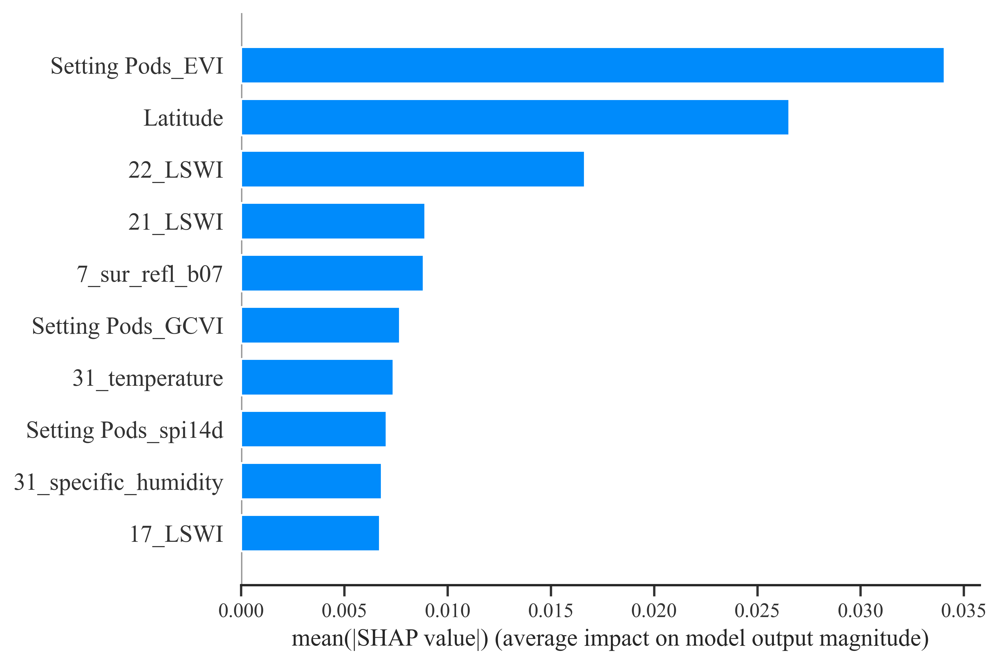

In [32]:
plt.figure(figsize=(5,10), dpi= 500)
shap.summary_plot(shap_values,max_display=10,plot_type = 'bar',show=False)
plt.savefig('D:\论文-产量趋势利用\可视化\python图\IMP_'+croptype+'_'+exp+'_'+str(test_year[0])+'_'+'.png',dpi=500, bbox_inches='tight')
plt.show()

In [25]:
shap_values.mean(axis=0)[0].max

<bound method Explanation.max of .values =
0.010563989

.base_values =
1.0716858

.data =
0.43400983994487125>

### 年份试验结果

In [26]:
# IAYF
def yield_predictor_year(data, test_year=[2020], N=2, experiment = 'NTP', croptype = 'soybean', model = ['XGBoost'], verbose = 0, 
                    tune_model = False, model_parameter=None, result = False, feature_importance = False,
                    fea_eng = False,seed = 99,save_model=False, save_model_dir='', result_dir = '',trend_n = 30,
                    importance_dir = '', feature_list = None, n_features = 200, metric_list = []):
    '''Yield predictor
    Parameters:
    
    '''
    print('seed:',seed, 'croptype:',croptype,' ','test_year:',test_year[0],' ',
          'experiment:',experiment,' ','training year:',N,' ','trend_n：',trend_n)
    # Encoding categry feature
    # one-hot encoding
    onehot_cols = ['State']
    new_onehot_cols = pd.get_dummies(data[onehot_cols]).columns.tolist()
    data.loc[:,new_onehot_cols] = pd.get_dummies(data[onehot_cols])
    # select features using features importance
    if experiment == 'IAYF': # IAYF
        IAYF_list = []
        for i in range(2,35):
            IAYF_list.append('yield_N'+str(i)+'_EXP2')

        feature_name = feature_list.iloc[0:n_features]['feature'].tolist()
        feature_name = ['sta_con','State','yield(t/ha)','Year']+feature_name+IAYF_list

        IAYF_list.remove('yield_N'+str(trend_n)+'_EXP2')
        
    if experiment == 'ILYF': # IlYF
        ILYF_list = []
        for i in [3,5,10,15,20,25,30,35]:
            ILYF_list.append('yield_N'+str(i)+'_EXP3')

        feature_name = feature_list.iloc[0:n_features]['feature'].tolist()
        feature_name = ['sta_con','State','yield(t/ha)','Year']+feature_name+ILYF_list

        ILYF_list.remove('yield_N'+str(trend_n)+'_EXP3')
#     print(IAYF_list)
    data = data[feature_name]
    data_test = data[data['Year'].isin(test_year)]
    data_train_val = data[data['Year'].isin([i for i in range(test_year[0]-N,test_year[0])])]
    # split input and output
    y_train_val = data_train_val['yield(t/ha)']
    y_test = data_test['yield(t/ha)']
    
    # Experimental setup
    # 1. no trend processing (NTP)
    # 2. Input year as a feature (IYF)
    # 3. Input average yield as a feature (IAYF)
    # 4. Input linear yield as a feature (ILYF)
    # 5. Global de-trending (GDT)
    if experiment == 'NTP': # NTP
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
    if experiment == 'IYF': # IYF
        X_train_val = data_train_val.drop(['sta_con','yield(t/ha)','State','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','yield(t/ha)','State','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        
    if experiment == 'IAYF': # IAYF
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year']+IAYF_list, axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year']+IAYF_list, axis=1)
        print(X_train_val.columns.tolist())
    
    if experiment == 'ILYF':  # ILYF
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year']+ILYF_list, axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year']+ILYF_list, axis=1)
        print(X_train_val.columns.tolist())
    if experiment == 'GDT': # GDT
        # de-trend the yield using linear model
        yield_mean = data_train_val['yield(t/ha)'].mean()
        linear_m = linear_model.LinearRegression()
        
        data_train_val1 = data[data['Year'].isin([i for i in range(test_year[0]-trend_n,test_year[0])])]
        X99 = np.array(data_train_val1['Year']).reshape(-1,1)
        Y99 = np.array(data_train_val1['yield(t/ha)']).reshape(-1,1)

        linear_m.fit(X99, Y99)
        if linear_m.coef_[0,0]<0:
            yield_mean = data_train_val['yield(t/ha)'].max()
        print('The foluma of de-trend the yield: yield_new = yield - {:.3f}×year + {:.3f} - ({:.3f})'
              .format(linear_m.coef_[0,0],yield_mean,linear_m.intercept_[0]))

        # de-trend data_train_val yield 
        data1 = data_train_val.copy()
        data1.loc[:,'yield(t/ha)_fix'] = data_train_val['yield(t/ha)'] - linear_m.coef_[0] * data_train_val['Year'] + yield_mean - linear_m.intercept_
        data1 = data1.drop(['yield(t/ha)'], axis = 1).rename({'yield(t/ha)_fix':'yield(t/ha)'}, axis=1)
        data_train_val = data1
        # de-trend data_test yield 
        data1 = data_test.copy()
        data1.loc[:,'yield(t/ha)_fix'] = data_test['yield(t/ha)'] - linear_m.coef_[0] * data_test['Year'] + yield_mean - linear_m.intercept_

        data1 = data1.drop(['yield(t/ha)'], axis = 1).rename({'yield(t/ha)_fix':'yield(t/ha)'}, axis=1)
        data_test = data1
        y_train_val = data_train_val['yield(t/ha)']
        y_test = data_test['yield(t/ha)']
        X_train_val = data_train_val.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1)
        X_test = data_test.drop(['sta_con','State','yield(t/ha)','Year','yield_N5_EXP2','yield_N30_EXP3','yield_N5_EXP20','yield_N30_EXP30'], axis=1) 
    else: None
        
    # Scale numeric features
    # not-numeric features list
    not_numeric_list = data.columns.tolist()[-12:]
    columns_to_scale = [item for item in X_train_val.columns.tolist() if item not in not_numeric_list]
    std_scaler = preprocessing.StandardScaler().fit(X_train_val[columns_to_scale])
    X_train_val.loc[:,columns_to_scale] = std_scaler.transform(X_train_val[columns_to_scale])
    X_test.loc[:,columns_to_scale] = std_scaler.transform(X_test[columns_to_scale])

    if tune_model:
        est_base = XGBRegressor(seed=99,objective='reg:gamma',
                           max_depth= 7, min_child_weight= 3,
                           colsample_bytree=0.7, subsample= 0.8,
                           reg_alpha= 0.1)#learning_rate=0.05,
        grid_XGBooxt = GridSearchCV(est_base,param_grid=model_parameter, cv=5,
                                    scoring=['r2','neg_mean_absolute_error',
                                            'neg_mean_squared_error',
                                            'neg_root_mean_squared_error'],
                                    n_jobs=-1,verbose=3,refit='r2')
        
        grid_XGBooxt.fit(X_train_val, y_train_val)
        print(" Results from Grid Search " )
        # print("\n The best estimator across ALL searched params:\n",grid_XGBooxt.best_estimator_)
        print("The best score across ALL searched params:\n",grid_XGBooxt.best_score_)
        print("The best parameters across ALL searched params:\n",grid_XGBooxt.best_params_)
        # print("\n The cv_results_:\n",grid_XGBooxt.cv_results_)
        est = grid_XGBooxt.best_estimator_
        
        if verbose == 0:
            model_lineresult(est,'XGBoost',test_year,X_train_val, X_test, y_train_val, y_test)
        else:
            model_result(est,X_train_val, X_test, y_train_val, y_test)
    else:
        est = XGBRegressor(max_depth= 7,learning_rate=0.09,n_estimators=700,seed=seed,objective='reg:gamma',
                           min_child_weight= 3,colsample_bytree=0.7, subsample= 0.8,reg_alpha= 0.1)#learning_rate=0.05,
        est.fit(X_train_val,y_train_val)
        if verbose == 0:
            RMSE,R2 = model_lineresult(est,'XGBoost',test_year,X_train_val, X_test, y_train_val, y_test)
        else:
            RMSE,R2 = model_result(est,X_train_val, X_test, y_train_val, y_test)
    
    # save the evaluated metrics
    
    metric_list.append([seed, croptype, test_year[0], experiment, N, trend_n, RMSE,R2])
   
    
    if save_model:
        dump(est, save_model_dir + croptype+'/'+ str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)) 
                                 
    if result:
        # get the yield and pred
        pred = est.predict(X_test)
        if croptype == 'maize':
            result = pd.concat([data.loc[y_test.index,['sta_con', 'yield(t/ha)']], pd.DataFrame(pred,index = y_test.index,columns=['pred'])],axis=1)
        else:
            result = pd.concat([data.loc[y_test.index,['sta_con', 'yield(t/ha)']], pd.DataFrame(pred,index = y_test.index,columns=['pred'])],axis=1)
        if experiment == 'GDT':
            result.loc[:,'pred'] = result.loc[:,'pred']+linear_m.coef_[0] * data_test['Year'] - yield_mean + linear_m.intercept_
        # result.loc[:,['yield','pred']] = result.loc[:,['yield','pred']]*62.719012*0.001
        result.loc[:,'residual'] =  result.loc[:,'pred'] - result.loc[:,'yield(t/ha)']
        result.to_csv(result_dir +croptype+'/'+str(seed) + '_' +'trend_n'+str(trend_n)+"_"+ str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)+'_预测结果.csv',header=True)
        # print('Results have been saved！')

    if feature_importance:
        importance_types = [ 'gain', 'cover', 'total_gain', 'total_cover']
        imp_dict = est.get_booster().get_score(importance_type = 'weight')
        imp_pd = pd.DataFrame.from_dict(imp_dict,orient ='index',columns = ['weight'])
        # print(imp_pd.index)
        for i in importance_types:
            imp_dict = est.get_booster().get_score(importance_type = i)
            imp_pd1 = pd.DataFrame.from_dict(imp_dict,orient ='index',columns = [i])
            imp_pd.loc[:,i] = imp_pd1.loc[:,i]
        imp_pd.to_csv(importance_dir +croptype+'/'+ str(test_year[0]) + '_' + model[0] + '_' + 'exp'+str(experiment)+'_N'+str(N)+'_特征重要性.csv',header=True)
        
    explainer = shap.Explainer(est)
    shap_values = explainer(X_test)

    return shap_values,metric_list#result #df_curve# imp_pd#

### 三个组别年份实验

In [9]:
# 2014-2021，每10年预测一年，试验条件为
data = read_data('D:/论文-产量趋势利用/数据/input_soybean_exp_ave.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/soybean/average feature importance.csv')
# data.drop(columns = 'name',inplace = True)

In [ ]:
# 大豆 IAYF trend_n 为【3,5,10,15,20,25,30,35】
metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
    for trend_n in [3,5,10,15,20,25,30]:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor_year(data,croptype = 'soybean', test_year = [year], N = 10, experiment = 'IAYF', model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,
                            trend_n = trend_n, feature_list = featurelist,result_dir = 'D:/论文-产量趋势利用/结果/年份实验/')
            name = ['seed', 'croptype', 'test_year', 'experiment', 'Train_years', 'trend_n', 'RMSE', 'R2']
metric_df = pd.DataFrame(columns = name, data=metric_list)
metric_df.to_csv('D:/论文-产量趋势利用/结果/年份实验/' +'soybean_IAYF' +'_预测指标(不同trend_n).csv',header=True)

In [ ]:
# 2014-2021，每10年预测一年，试验条件为
data = read_data('D:/论文-产量趋势利用/数据/input_soybean_exp_lin.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/soybean/average feature importance.csv')
# 大豆 ILYF trend_n 为【3,5,10,15,20,25,30,35】
metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
    for trend_n in [3,5,10,15,20,25,30]:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor_year(data,croptype = 'soybean', test_year = [year], N = 10, experiment = 'ILYF', model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,
                            trend_n = trend_n, feature_list = featurelist,result_dir = 'D:/论文-产量趋势利用/结果/年份实验/')
            name = ['seed', 'croptype', 'test_year', 'experiment', 'Train_years', 'trend_n', 'RMSE', 'R2']
metric_df = pd.DataFrame(columns = name, data=metric_list)
metric_df.to_csv('D:/论文-产量趋势利用/结果/年份实验/' +'soybean_ILYF' +'_预测指标(不同trend_n).csv',header=True)

### 五个实验组试验结果

In [7]:
# 2014-2021，每10年预测一年，调优，试验条件为0
data = read_data('D:/论文-产量趋势利用/数据/input_soybean_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/soybean/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

In [ ]:
# 大豆
metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
    for exp in ['NTP', 'IYF', 'IAYF', 'ILYF', 'GDT']:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor(data,croptype = 'soybean', test_year = [year], N = 10, experiment = exp, model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,feature_list = featurelist,
                            result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')
            name = ['seed', 'croptype', 'test_year', 'experiment', 'Train_years', 'trend_n', 'RMSE', 'R2']
metric_df = pd.DataFrame(columns = name, data=metric_list)
metric_df.to_csv('D:/论文-产量趋势利用/结果/' +'soybean_' +'_预测指标.csv',header=True)

In [68]:
# 2014-2021，每10年预测一年，调优，试验条件为0
data = read_data('D:/论文-产量趋势利用/数据/input_maize_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/maize/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

In [ ]:
# 玉米
metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
    for exp in ['NTP', 'IYF', 'IAYF', 'ILYF', 'GDT']:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor(data,croptype = 'maize', test_year = [year], N = 10, experiment = exp, model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,feature_list = featurelist,
                            result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')
            name = ['seed', 'croptype', 'test_year', 'experiment', 'Train_years', 'trend_n', 'RMSE', 'R2']
metric_df = pd.DataFrame(columns = name, data=metric_list)
metric_df.to_csv('D:/论文-产量趋势利用/结果/' +'maize_' +'_预测指标.csv',header=True)

In [9]:
### 补做GDT的结果
# 大豆
metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor(data,croptype = 'soybean', test_year = [year], N = 10, experiment = 'GDT', model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,feature_list = featurelist,
                            result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

seed: 9 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0168
Train_R2: 0.9992
----
Test_MAE: 0.2155
Test_MSE: 0.0734
Test_RMSE: 0.2709
Test_R2: 0.7555


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0103
Train_MSE: 0.0003
Train_RMSE: 0.0173
Train_R2: 0.9991
----
Test_MAE: 0.2146
Test_MSE: 0.0753
Test_RMSE: 0.2745
Test_R2: 0.7640


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0103
Train_MSE: 0.0003
Train_RMSE: 0.0174
Train_R2: 0.9991
----
Test_MAE: 0.2743
Test_MSE: 0.1107
Test_RMSE: 0.3328
Test_R2: 0.5519


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0165
Train_R2: 0.9992
----
Test_MAE: 0.2159
Test_MSE: 0.0759
Test_RMSE: 0.2755
Test_R2: 0.7740


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0165
Train_R2: 0.9992
----
Test_MAE: 0.2462
Test_MSE: 0.1069
Test_RMSE: 0.3270
Test_R2: 0.7571


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2140
Test_MSE: 0.0746
Test_RMSE: 0.2732
Test_R2: 0.7654


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0162
Train_R2: 0.9993
----
Test_MAE: 0.2420
Test_MSE: 0.0984
Test_RMSE: 0.3137
Test_R2: 0.7459


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0100
Train_MSE: 0.0002
Train_RMSE: 0.0157
Train_R2: 0.9994
----
Test_MAE: 0.2852
Test_MSE: 0.1482
Test_RMSE: 0.3850
Test_R2: 0.8055


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0170
Train_R2: 0.9992
----
Test_MAE: 0.2162
Test_MSE: 0.0745
Test_RMSE: 0.2730
Test_R2: 0.7518


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0105
Train_MSE: 0.0003
Train_RMSE: 0.0177
Train_R2: 0.9991
----
Test_MAE: 0.2038
Test_MSE: 0.0689
Test_RMSE: 0.2625
Test_R2: 0.7841


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0169
Train_R2: 0.9992
----
Test_MAE: 0.2737
Test_MSE: 0.1108
Test_RMSE: 0.3329
Test_R2: 0.5516


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0167
Train_R2: 0.9992
----
Test_MAE: 0.2110
Test_MSE: 0.0718
Test_RMSE: 0.2679
Test_R2: 0.7864


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0097
Train_MSE: 0.0003
Train_RMSE: 0.0162
Train_R2: 0.9993
----
Test_MAE: 0.2497
Test_MSE: 0.1144
Test_RMSE: 0.3382
Test_R2: 0.7402


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2061
Test_MSE: 0.0690
Test_RMSE: 0.2627
Test_R2: 0.7832


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2446
Test_MSE: 0.0976
Test_RMSE: 0.3124
Test_R2: 0.7480


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0097
Train_MSE: 0.0002
Train_RMSE: 0.0154
Train_R2: 0.9994
----
Test_MAE: 0.2714
Test_MSE: 0.1348
Test_RMSE: 0.3672
Test_R2: 0.8231


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0104
Train_MSE: 0.0003
Train_RMSE: 0.0174
Train_R2: 0.9992
----
Test_MAE: 0.2278
Test_MSE: 0.0830
Test_RMSE: 0.2881
Test_R2: 0.7235


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0103
Train_MSE: 0.0003
Train_RMSE: 0.0173
Train_R2: 0.9991
----
Test_MAE: 0.2004
Test_MSE: 0.0653
Test_RMSE: 0.2556
Test_R2: 0.7953


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0169
Train_R2: 0.9992
----
Test_MAE: 0.2811
Test_MSE: 0.1145
Test_RMSE: 0.3384
Test_R2: 0.5366


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0163
Train_R2: 0.9993
----
Test_MAE: 0.2122
Test_MSE: 0.0722
Test_RMSE: 0.2687
Test_R2: 0.7851


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0163
Train_R2: 0.9993
----
Test_MAE: 0.2478
Test_MSE: 0.1099
Test_RMSE: 0.3314
Test_R2: 0.7504


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0097
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2150
Test_MSE: 0.0739
Test_RMSE: 0.2719
Test_R2: 0.7677


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2384
Test_MSE: 0.0992
Test_RMSE: 0.3149
Test_R2: 0.7439


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0097
Train_MSE: 0.0002
Train_RMSE: 0.0155
Train_R2: 0.9994
----
Test_MAE: 0.2716
Test_MSE: 0.1339
Test_RMSE: 0.3659
Test_R2: 0.8243


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0171
Train_R2: 0.9992
----
Test_MAE: 0.2249
Test_MSE: 0.0808
Test_RMSE: 0.2842
Test_R2: 0.7310


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0104
Train_MSE: 0.0003
Train_RMSE: 0.0175
Train_R2: 0.9991
----
Test_MAE: 0.2164
Test_MSE: 0.0752
Test_RMSE: 0.2742
Test_R2: 0.7645


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0103
Train_MSE: 0.0003
Train_RMSE: 0.0172
Train_R2: 0.9992
----
Test_MAE: 0.2802
Test_MSE: 0.1125
Test_RMSE: 0.3355
Test_R2: 0.5446


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0163
Train_R2: 0.9993
----
Test_MAE: 0.2139
Test_MSE: 0.0726
Test_RMSE: 0.2694
Test_R2: 0.7840


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0165
Train_R2: 0.9992
----
Test_MAE: 0.2377
Test_MSE: 0.1023
Test_RMSE: 0.3199
Test_R2: 0.7676


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2187
Test_MSE: 0.0786
Test_RMSE: 0.2804
Test_R2: 0.7529


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2418
Test_MSE: 0.0962
Test_RMSE: 0.3102
Test_R2: 0.7515


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0098
Train_MSE: 0.0002
Train_RMSE: 0.0155
Train_R2: 0.9994
----
Test_MAE: 0.2743
Test_MSE: 0.1308
Test_RMSE: 0.3617
Test_R2: 0.8283


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0097
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9993
----
Test_MAE: 0.2201
Test_MSE: 0.0779
Test_RMSE: 0.2791
Test_R2: 0.7406


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0104
Train_MSE: 0.0003
Train_RMSE: 0.0174
Train_R2: 0.9991
----
Test_MAE: 0.2080
Test_MSE: 0.0706
Test_RMSE: 0.2658
Test_R2: 0.7787


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0170
Train_R2: 0.9992
----
Test_MAE: 0.2771
Test_MSE: 0.1120
Test_RMSE: 0.3347
Test_R2: 0.5467


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0167
Train_R2: 0.9992
----
Test_MAE: 0.2181
Test_MSE: 0.0776
Test_RMSE: 0.2786
Test_R2: 0.7689


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0164
Train_R2: 0.9992
----
Test_MAE: 0.2348
Test_MSE: 0.0990
Test_RMSE: 0.3147
Test_R2: 0.7750


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0158
Train_R2: 0.9993
----
Test_MAE: 0.2172
Test_MSE: 0.0762
Test_RMSE: 0.2761
Test_R2: 0.7604


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2421
Test_MSE: 0.0969
Test_RMSE: 0.3114
Test_R2: 0.7497


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2764
Test_MSE: 0.1412
Test_RMSE: 0.3758
Test_R2: 0.8147


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9993
----
Test_MAE: 0.2142
Test_MSE: 0.0742
Test_RMSE: 0.2723
Test_R2: 0.7530


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0102
Train_MSE: 0.0003
Train_RMSE: 0.0172
Train_R2: 0.9992
----
Test_MAE: 0.2191
Test_MSE: 0.0767
Test_RMSE: 0.2769
Test_R2: 0.7598


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0171
Train_R2: 0.9992
----
Test_MAE: 0.2942
Test_MSE: 0.1237
Test_RMSE: 0.3517
Test_R2: 0.4996


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0164
Train_R2: 0.9992
----
Test_MAE: 0.2136
Test_MSE: 0.0714
Test_RMSE: 0.2672
Test_R2: 0.7875


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9992
----
Test_MAE: 0.2420
Test_MSE: 0.1095
Test_RMSE: 0.3309
Test_R2: 0.7512


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0163
Train_R2: 0.9993
----
Test_MAE: 0.2179
Test_MSE: 0.0767
Test_RMSE: 0.2770
Test_R2: 0.7588


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2445
Test_MSE: 0.0987
Test_RMSE: 0.3141
Test_R2: 0.7452


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0098
Train_MSE: 0.0002
Train_RMSE: 0.0155
Train_R2: 0.9994
----
Test_MAE: 0.2821
Test_MSE: 0.1441
Test_RMSE: 0.3796
Test_R2: 0.8109


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0169
Train_R2: 0.9992
----
Test_MAE: 0.2105
Test_MSE: 0.0730
Test_RMSE: 0.2702
Test_R2: 0.7568


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0103
Train_MSE: 0.0003
Train_RMSE: 0.0174
Train_R2: 0.9991
----
Test_MAE: 0.2077
Test_MSE: 0.0703
Test_RMSE: 0.2651
Test_R2: 0.7798


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0105
Train_MSE: 0.0003
Train_RMSE: 0.0175
Train_R2: 0.9991
----
Test_MAE: 0.2705
Test_MSE: 0.1066
Test_RMSE: 0.3265
Test_R2: 0.5686


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9992
----
Test_MAE: 0.2164
Test_MSE: 0.0750
Test_RMSE: 0.2739
Test_R2: 0.7768


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9992
----
Test_MAE: 0.2524
Test_MSE: 0.1194
Test_RMSE: 0.3455
Test_R2: 0.7288


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2221
Test_MSE: 0.0787
Test_RMSE: 0.2806
Test_R2: 0.7526


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0097
Train_MSE: 0.0002
Train_RMSE: 0.0158
Train_R2: 0.9993
----
Test_MAE: 0.2437
Test_MSE: 0.1005
Test_RMSE: 0.3170
Test_R2: 0.7406


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0097
Train_MSE: 0.0002
Train_RMSE: 0.0153
Train_R2: 0.9994
----
Test_MAE: 0.2767
Test_MSE: 0.1353
Test_RMSE: 0.3678
Test_R2: 0.8225


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0170
Train_R2: 0.9992
----
Test_MAE: 0.2235
Test_MSE: 0.0804
Test_RMSE: 0.2835
Test_R2: 0.7324


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0105
Train_MSE: 0.0003
Train_RMSE: 0.0177
Train_R2: 0.9991
----
Test_MAE: 0.2145
Test_MSE: 0.0739
Test_RMSE: 0.2719
Test_R2: 0.7684


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0169
Train_R2: 0.9992
----
Test_MAE: 0.2827
Test_MSE: 0.1141
Test_RMSE: 0.3379
Test_R2: 0.5381


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9992
----
Test_MAE: 0.2125
Test_MSE: 0.0713
Test_RMSE: 0.2669
Test_R2: 0.7879


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0165
Train_R2: 0.9992
----
Test_MAE: 0.2566
Test_MSE: 0.1196
Test_RMSE: 0.3459
Test_R2: 0.7282


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0098
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2209
Test_MSE: 0.0801
Test_RMSE: 0.2830
Test_R2: 0.7482


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2378
Test_MSE: 0.0981
Test_RMSE: 0.3132
Test_R2: 0.7466


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0098
Train_MSE: 0.0002
Train_RMSE: 0.0154
Train_R2: 0.9994
----
Test_MAE: 0.2718
Test_MSE: 0.1296
Test_RMSE: 0.3600
Test_R2: 0.8299


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0168
Train_R2: 0.9992
----
Test_MAE: 0.2215
Test_MSE: 0.0786
Test_RMSE: 0.2803
Test_R2: 0.7383


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0102
Train_MSE: 0.0003
Train_RMSE: 0.0172
Train_R2: 0.9992
----
Test_MAE: 0.2145
Test_MSE: 0.0746
Test_RMSE: 0.2731
Test_R2: 0.7663


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0102
Train_MSE: 0.0003
Train_RMSE: 0.0174
Train_R2: 0.9991
----
Test_MAE: 0.2735
Test_MSE: 0.1097
Test_RMSE: 0.3313
Test_R2: 0.5560


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0164
Train_R2: 0.9993
----
Test_MAE: 0.2077
Test_MSE: 0.0698
Test_RMSE: 0.2642
Test_R2: 0.7922


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0167
Train_R2: 0.9992
----
Test_MAE: 0.2520
Test_MSE: 0.1134
Test_RMSE: 0.3367
Test_R2: 0.7424


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0159
Train_R2: 0.9993
----
Test_MAE: 0.2184
Test_MSE: 0.0781
Test_RMSE: 0.2795
Test_R2: 0.7545


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0161
Train_R2: 0.9993
----
Test_MAE: 0.2416
Test_MSE: 0.0969
Test_RMSE: 0.3113
Test_R2: 0.7497


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0099
Train_MSE: 0.0002
Train_RMSE: 0.0155
Train_R2: 0.9994
----
Test_MAE: 0.2696
Test_MSE: 0.1235
Test_RMSE: 0.3514
Test_R2: 0.8380


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.915 - (-58.235)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0171
Train_R2: 0.9992
----
Test_MAE: 0.2156
Test_MSE: 0.0770
Test_RMSE: 0.2775
Test_R2: 0.7435


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.030×year + 2.962 - (-57.658)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0171
Train_R2: 0.9992
----
Test_MAE: 0.2182
Test_MSE: 0.0753
Test_RMSE: 0.2744
Test_R2: 0.7641


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.033×year + 3.003 - (-63.403)
----
Train_MAE: 0.0101
Train_MSE: 0.0003
Train_RMSE: 0.0170
Train_R2: 0.9992
----
Test_MAE: 0.2844
Test_MSE: 0.1156
Test_RMSE: 0.3400
Test_R2: 0.5323


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.073 - (-72.756)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0165
Train_R2: 0.9992
----
Test_MAE: 0.2188
Test_MSE: 0.0783
Test_RMSE: 0.2798
Test_R2: 0.7669


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.040×year + 3.124 - (-78.120)
----
Train_MAE: 0.0100
Train_MSE: 0.0003
Train_RMSE: 0.0166
Train_R2: 0.9992
----
Test_MAE: 0.2541
Test_MSE: 0.1170
Test_RMSE: 0.3420
Test_R2: 0.7343


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.204 - (-74.658)
----
Train_MAE: 0.0098
Train_MSE: 0.0002
Train_RMSE: 0.0158
Train_R2: 0.9993
----
Test_MAE: 0.2231
Test_MSE: 0.0801
Test_RMSE: 0.2830
Test_R2: 0.7482


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.038×year + 3.226 - (-72.845)
----
Train_MAE: 0.0099
Train_MSE: 0.0003
Train_RMSE: 0.0160
Train_R2: 0.9993
----
Test_MAE: 0.2429
Test_MSE: 0.0971
Test_RMSE: 0.3116
Test_R2: 0.7493


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: soybean   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.039×year + 3.266 - (-75.237)
----
Train_MAE: 0.0098
Train_MSE: 0.0002
Train_RMSE: 0.0156
Train_R2: 0.9994
----
Test_MAE: 0.2623
Test_MSE: 0.1214
Test_RMSE: 0.3484
Test_R2: 0.8407


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


In [10]:
### 补做GDT的结果
# 玉米
# 2014-2021，每10年预测一年，调优，试验条件为0
data = read_data('D:/论文-产量趋势利用/数据/input_maize_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/maize/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

metric_list = []
for seed in [9,19,29,39,49,59,69,79,89,99]:
        for year in range(2014,2022):
            shap_values,metric_list = yield_predictor(data,croptype = 'maize', test_year = [year], N = 10, experiment = 'GDT', model = ['XGBoost'],
                            verbose = 1, result = True,seed = seed, feature_importance  = False,metric_list = metric_list,feature_list = featurelist,
                            result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

seed: 9 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0323
Train_MSE: 0.0022
Train_RMSE: 0.0471
Train_R2: 0.9995
----
Test_MAE: 0.6898
Test_MSE: 0.7928
Test_RMSE: 0.8904
Test_R2: 0.7304


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0321
Train_MSE: 0.0022
Train_RMSE: 0.0466
Train_R2: 0.9995
----
Test_MAE: 0.6861
Test_MSE: 0.8484
Test_RMSE: 0.9211
Test_R2: 0.7079


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0307
Train_MSE: 0.0020
Train_RMSE: 0.0449
Train_R2: 0.9995
----
Test_MAE: 0.6791
Test_MSE: 0.7624
Test_RMSE: 0.8732
Test_R2: 0.7200


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0303
Train_MSE: 0.0020
Train_RMSE: 0.0446
Train_R2: 0.9995
----
Test_MAE: 0.6848
Test_MSE: 0.7725
Test_RMSE: 0.8789
Test_R2: 0.7650


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0299
Train_MSE: 0.0019
Train_RMSE: 0.0439
Train_R2: 0.9995
----
Test_MAE: 0.7034
Test_MSE: 0.8412
Test_RMSE: 0.9172
Test_R2: 0.7525


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0303
Train_MSE: 0.0019
Train_RMSE: 0.0438
Train_R2: 0.9995
----
Test_MAE: 0.6791
Test_MSE: 0.7184
Test_RMSE: 0.8476
Test_R2: 0.6859


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0300
Train_MSE: 0.0018
Train_RMSE: 0.0425
Train_R2: 0.9996
----
Test_MAE: 0.7041
Test_MSE: 0.8499
Test_RMSE: 0.9219
Test_R2: 0.6937


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 9 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0296
Train_MSE: 0.0018
Train_RMSE: 0.0420
Train_R2: 0.9996
----
Test_MAE: 0.7935
Test_MSE: 1.1750
Test_RMSE: 1.0840
Test_R2: 0.8060


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0327
Train_MSE: 0.0022
Train_RMSE: 0.0474
Train_R2: 0.9995
----
Test_MAE: 0.6464
Test_MSE: 0.7293
Test_RMSE: 0.8540
Test_R2: 0.7520


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0317
Train_MSE: 0.0021
Train_RMSE: 0.0463
Train_R2: 0.9995
----
Test_MAE: 0.6768
Test_MSE: 0.8607
Test_RMSE: 0.9277
Test_R2: 0.7036


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0310
Train_MSE: 0.0020
Train_RMSE: 0.0451
Train_R2: 0.9995
----
Test_MAE: 0.6630
Test_MSE: 0.6967
Test_RMSE: 0.8347
Test_R2: 0.7441


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0303
Train_MSE: 0.0020
Train_RMSE: 0.0447
Train_R2: 0.9995
----
Test_MAE: 0.6977
Test_MSE: 0.7743
Test_RMSE: 0.8799
Test_R2: 0.7644


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0301
Train_MSE: 0.0019
Train_RMSE: 0.0440
Train_R2: 0.9995
----
Test_MAE: 0.7518
Test_MSE: 0.9151
Test_RMSE: 0.9566
Test_R2: 0.7307


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0443
Train_R2: 0.9995
----
Test_MAE: 0.6757
Test_MSE: 0.7107
Test_RMSE: 0.8430
Test_R2: 0.6892


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0296
Train_MSE: 0.0018
Train_RMSE: 0.0421
Train_R2: 0.9996
----
Test_MAE: 0.7508
Test_MSE: 0.9342
Test_RMSE: 0.9666
Test_R2: 0.6633


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 19 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0299
Train_MSE: 0.0018
Train_RMSE: 0.0421
Train_R2: 0.9996
----
Test_MAE: 0.7699
Test_MSE: 1.1343
Test_RMSE: 1.0650
Test_R2: 0.8127


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0325
Train_MSE: 0.0022
Train_RMSE: 0.0470
Train_R2: 0.9995
----
Test_MAE: 0.6403
Test_MSE: 0.6990
Test_RMSE: 0.8361
Test_R2: 0.7623


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0314
Train_MSE: 0.0020
Train_RMSE: 0.0452
Train_R2: 0.9995
----
Test_MAE: 0.6729
Test_MSE: 0.8545
Test_RMSE: 0.9244
Test_R2: 0.7058


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0310
Train_MSE: 0.0020
Train_RMSE: 0.0451
Train_R2: 0.9995
----
Test_MAE: 0.6597
Test_MSE: 0.7077
Test_RMSE: 0.8412
Test_R2: 0.7401


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0305
Train_MSE: 0.0020
Train_RMSE: 0.0446
Train_R2: 0.9995
----
Test_MAE: 0.7391
Test_MSE: 0.8903
Test_RMSE: 0.9436
Test_R2: 0.7291


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0303
Train_MSE: 0.0019
Train_RMSE: 0.0439
Train_R2: 0.9995
----
Test_MAE: 0.7402
Test_MSE: 0.9120
Test_RMSE: 0.9550
Test_R2: 0.7316


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0302
Train_MSE: 0.0019
Train_RMSE: 0.0439
Train_R2: 0.9995
----
Test_MAE: 0.6871
Test_MSE: 0.7533
Test_RMSE: 0.8679
Test_R2: 0.6706


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0296
Train_MSE: 0.0018
Train_RMSE: 0.0420
Train_R2: 0.9996
----
Test_MAE: 0.7033
Test_MSE: 0.8385
Test_RMSE: 0.9157
Test_R2: 0.6978


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 29 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0298
Train_MSE: 0.0018
Train_RMSE: 0.0419
Train_R2: 0.9996
----
Test_MAE: 0.7759
Test_MSE: 1.1337
Test_RMSE: 1.0647
Test_R2: 0.8128


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0325
Train_MSE: 0.0022
Train_RMSE: 0.0473
Train_R2: 0.9995
----
Test_MAE: 0.6897
Test_MSE: 0.7633
Test_RMSE: 0.8736
Test_R2: 0.7405


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0311
Train_MSE: 0.0021
Train_RMSE: 0.0455
Train_R2: 0.9995
----
Test_MAE: 0.7255
Test_MSE: 0.9505
Test_RMSE: 0.9749
Test_R2: 0.6727


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0451
Train_R2: 0.9995
----
Test_MAE: 0.6795
Test_MSE: 0.7261
Test_RMSE: 0.8521
Test_R2: 0.7333


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0450
Train_R2: 0.9995
----
Test_MAE: 0.6773
Test_MSE: 0.7413
Test_RMSE: 0.8610
Test_R2: 0.7745


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0446
Train_R2: 0.9995
----
Test_MAE: 0.7057
Test_MSE: 0.8339
Test_RMSE: 0.9132
Test_R2: 0.7546


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0310
Train_MSE: 0.0020
Train_RMSE: 0.0448
Train_R2: 0.9995
----
Test_MAE: 0.6908
Test_MSE: 0.7568
Test_RMSE: 0.8699
Test_R2: 0.6691


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0303
Train_MSE: 0.0018
Train_RMSE: 0.0428
Train_R2: 0.9996
----
Test_MAE: 0.7306
Test_MSE: 0.9254
Test_RMSE: 0.9620
Test_R2: 0.6665


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 39 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0295
Train_MSE: 0.0017
Train_RMSE: 0.0418
Train_R2: 0.9996
----
Test_MAE: 0.7626
Test_MSE: 1.0897
Test_RMSE: 1.0439
Test_R2: 0.8201


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0331
Train_MSE: 0.0023
Train_RMSE: 0.0479
Train_R2: 0.9994
----
Test_MAE: 0.6690
Test_MSE: 0.7577
Test_RMSE: 0.8705
Test_R2: 0.7424


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0316
Train_MSE: 0.0021
Train_RMSE: 0.0458
Train_R2: 0.9995
----
Test_MAE: 0.6448
Test_MSE: 0.7722
Test_RMSE: 0.8788
Test_R2: 0.7341


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0307
Train_MSE: 0.0020
Train_RMSE: 0.0447
Train_R2: 0.9995
----
Test_MAE: 0.6661
Test_MSE: 0.7071
Test_RMSE: 0.8409
Test_R2: 0.7403


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0448
Train_R2: 0.9995
----
Test_MAE: 0.7147
Test_MSE: 0.8525
Test_RMSE: 0.9233
Test_R2: 0.7406


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0304
Train_MSE: 0.0020
Train_RMSE: 0.0443
Train_R2: 0.9995
----
Test_MAE: 0.7548
Test_MSE: 0.9476
Test_RMSE: 0.9735
Test_R2: 0.7212


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0446
Train_R2: 0.9995
----
Test_MAE: 0.6751
Test_MSE: 0.7089
Test_RMSE: 0.8420
Test_R2: 0.6900


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0299
Train_MSE: 0.0018
Train_RMSE: 0.0423
Train_R2: 0.9996
----
Test_MAE: 0.7434
Test_MSE: 0.9377
Test_RMSE: 0.9684
Test_R2: 0.6620


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 49 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0294
Train_MSE: 0.0017
Train_RMSE: 0.0416
Train_R2: 0.9996
----
Test_MAE: 0.7872
Test_MSE: 1.1283
Test_RMSE: 1.0622
Test_R2: 0.8137


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0332
Train_MSE: 0.0023
Train_RMSE: 0.0478
Train_R2: 0.9994
----
Test_MAE: 0.6510
Test_MSE: 0.7403
Test_RMSE: 0.8604
Test_R2: 0.7483


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0320
Train_MSE: 0.0022
Train_RMSE: 0.0465
Train_R2: 0.9995
----
Test_MAE: 0.6686
Test_MSE: 0.8345
Test_RMSE: 0.9135
Test_R2: 0.7127


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0450
Train_R2: 0.9995
----
Test_MAE: 0.6549
Test_MSE: 0.7094
Test_RMSE: 0.8423
Test_R2: 0.7394


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0452
Train_R2: 0.9995
----
Test_MAE: 0.7631
Test_MSE: 0.9645
Test_RMSE: 0.9821
Test_R2: 0.7065


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0305
Train_MSE: 0.0020
Train_RMSE: 0.0445
Train_R2: 0.9995
----
Test_MAE: 0.6954
Test_MSE: 0.8219
Test_RMSE: 0.9066
Test_R2: 0.7582


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0448
Train_R2: 0.9995
----
Test_MAE: 0.6710
Test_MSE: 0.7198
Test_RMSE: 0.8484
Test_R2: 0.6853


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0301
Train_MSE: 0.0018
Train_RMSE: 0.0428
Train_R2: 0.9996
----
Test_MAE: 0.7455
Test_MSE: 0.9272
Test_RMSE: 0.9629
Test_R2: 0.6658


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 59 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0297
Train_MSE: 0.0018
Train_RMSE: 0.0419
Train_R2: 0.9996
----
Test_MAE: 0.7810
Test_MSE: 1.1413
Test_RMSE: 1.0683
Test_R2: 0.8116


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0322
Train_MSE: 0.0022
Train_RMSE: 0.0469
Train_R2: 0.9995
----
Test_MAE: 0.6334
Test_MSE: 0.6947
Test_RMSE: 0.8335
Test_R2: 0.7638


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0314
Train_MSE: 0.0021
Train_RMSE: 0.0456
Train_R2: 0.9995
----
Test_MAE: 0.6829
Test_MSE: 0.8889
Test_RMSE: 0.9428
Test_R2: 0.6939


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0450
Train_R2: 0.9995
----
Test_MAE: 0.6457
Test_MSE: 0.6875
Test_RMSE: 0.8292
Test_R2: 0.7475


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0308
Train_MSE: 0.0021
Train_RMSE: 0.0454
Train_R2: 0.9995
----
Test_MAE: 0.6769
Test_MSE: 0.7540
Test_RMSE: 0.8683
Test_R2: 0.7706


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0306
Train_MSE: 0.0020
Train_RMSE: 0.0443
Train_R2: 0.9995
----
Test_MAE: 0.7414
Test_MSE: 0.8971
Test_RMSE: 0.9471
Test_R2: 0.7360


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0304
Train_MSE: 0.0020
Train_RMSE: 0.0444
Train_R2: 0.9995
----
Test_MAE: 0.6917
Test_MSE: 0.7609
Test_RMSE: 0.8723
Test_R2: 0.6673


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0299
Train_MSE: 0.0018
Train_RMSE: 0.0425
Train_R2: 0.9996
----
Test_MAE: 0.7052
Test_MSE: 0.8466
Test_RMSE: 0.9201
Test_R2: 0.6949


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 69 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0297
Train_MSE: 0.0018
Train_RMSE: 0.0420
Train_R2: 0.9996
----
Test_MAE: 0.7541
Test_MSE: 1.0812
Test_RMSE: 1.0398
Test_R2: 0.8215


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0320
Train_MSE: 0.0022
Train_RMSE: 0.0465
Train_R2: 0.9995
----
Test_MAE: 0.6587
Test_MSE: 0.7225
Test_RMSE: 0.8500
Test_R2: 0.7543


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0313
Train_MSE: 0.0021
Train_RMSE: 0.0455
Train_R2: 0.9995
----
Test_MAE: 0.6796
Test_MSE: 0.8332
Test_RMSE: 0.9128
Test_R2: 0.7131


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0450
Train_R2: 0.9995
----
Test_MAE: 0.6721
Test_MSE: 0.7242
Test_RMSE: 0.8510
Test_R2: 0.7340


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0305
Train_MSE: 0.0020
Train_RMSE: 0.0447
Train_R2: 0.9995
----
Test_MAE: 0.7252
Test_MSE: 0.8567
Test_RMSE: 0.9256
Test_R2: 0.7394


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0304
Train_MSE: 0.0019
Train_RMSE: 0.0441
Train_R2: 0.9995
----
Test_MAE: 0.7693
Test_MSE: 0.9363
Test_RMSE: 0.9676
Test_R2: 0.7245


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0446
Train_R2: 0.9995
----
Test_MAE: 0.6854
Test_MSE: 0.7373
Test_RMSE: 0.8586
Test_R2: 0.6776


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0293
Train_MSE: 0.0017
Train_RMSE: 0.0415
Train_R2: 0.9996
----
Test_MAE: 0.7530
Test_MSE: 0.9606
Test_RMSE: 0.9801
Test_R2: 0.6538


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 79 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0299
Train_MSE: 0.0018
Train_RMSE: 0.0424
Train_R2: 0.9996
----
Test_MAE: 0.7868
Test_MSE: 1.1416
Test_RMSE: 1.0684
Test_R2: 0.8115


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0328
Train_MSE: 0.0023
Train_RMSE: 0.0475
Train_R2: 0.9995
----
Test_MAE: 0.6544
Test_MSE: 0.7124
Test_RMSE: 0.8440
Test_R2: 0.7578


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0317
Train_MSE: 0.0021
Train_RMSE: 0.0461
Train_R2: 0.9995
----
Test_MAE: 0.6737
Test_MSE: 0.8231
Test_RMSE: 0.9072
Test_R2: 0.7166


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0308
Train_MSE: 0.0020
Train_RMSE: 0.0448
Train_R2: 0.9995
----
Test_MAE: 0.6558
Test_MSE: 0.6964
Test_RMSE: 0.8345
Test_R2: 0.7442


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0310
Train_MSE: 0.0021
Train_RMSE: 0.0455
Train_R2: 0.9995
----
Test_MAE: 0.6950
Test_MSE: 0.7623
Test_RMSE: 0.8731
Test_R2: 0.7681


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0301
Train_MSE: 0.0019
Train_RMSE: 0.0436
Train_R2: 0.9995
----
Test_MAE: 0.7121
Test_MSE: 0.8368
Test_RMSE: 0.9148
Test_R2: 0.7538


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0305
Train_MSE: 0.0019
Train_RMSE: 0.0439
Train_R2: 0.9995
----
Test_MAE: 0.7206
Test_MSE: 0.8320
Test_RMSE: 0.9121
Test_R2: 0.6362


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0302
Train_MSE: 0.0018
Train_RMSE: 0.0428
Train_R2: 0.9996
----
Test_MAE: 0.7275
Test_MSE: 0.9027
Test_RMSE: 0.9501
Test_R2: 0.6746


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 89 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0297
Train_MSE: 0.0017
Train_RMSE: 0.0417
Train_R2: 0.9996
----
Test_MAE: 0.7810
Test_MSE: 1.1670
Test_RMSE: 1.0803
Test_R2: 0.8073


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2014   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.117×year + 9.097 - (-226.754)
----
Train_MAE: 0.0325
Train_MSE: 0.0022
Train_RMSE: 0.0470
Train_R2: 0.9995
----
Test_MAE: 0.6582
Test_MSE: 0.7444
Test_RMSE: 0.8628
Test_R2: 0.7469


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2015   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.124×year + 9.205 - (-240.281)
----
Train_MAE: 0.0310
Train_MSE: 0.0020
Train_RMSE: 0.0451
Train_R2: 0.9995
----
Test_MAE: 0.6827
Test_MSE: 0.8782
Test_RMSE: 0.9371
Test_R2: 0.6976


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2016   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.133×year + 9.360 - (-257.905)
----
Train_MAE: 0.0309
Train_MSE: 0.0020
Train_RMSE: 0.0451
Train_R2: 0.9995
----
Test_MAE: 0.6802
Test_MSE: 0.7380
Test_RMSE: 0.8591
Test_R2: 0.7289


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2017   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.146×year + 9.553 - (-284.378)
----
Train_MAE: 0.0307
Train_MSE: 0.0020
Train_RMSE: 0.0450
Train_R2: 0.9995
----
Test_MAE: 0.6995
Test_MSE: 0.7881
Test_RMSE: 0.8878
Test_R2: 0.7602


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2018   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 9.770 - (-308.861)
----
Train_MAE: 0.0307
Train_MSE: 0.0020
Train_RMSE: 0.0444
Train_R2: 0.9995
----
Test_MAE: 0.7035
Test_MSE: 0.8267
Test_RMSE: 0.9092
Test_R2: 0.7567


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2019   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.153×year + 9.946 - (-298.934)
----
Train_MAE: 0.0305
Train_MSE: 0.0020
Train_RMSE: 0.0442
Train_R2: 0.9995
----
Test_MAE: 0.6773
Test_MSE: 0.7392
Test_RMSE: 0.8597
Test_R2: 0.6768


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2020   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.155×year + 9.982 - (-302.407)
----
Train_MAE: 0.0298
Train_MSE: 0.0018
Train_RMSE: 0.0424
Train_R2: 0.9996
----
Test_MAE: 0.7210
Test_MSE: 0.8920
Test_RMSE: 0.9444
Test_R2: 0.6785


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


seed: 99 croptype: maize   test_year: 2021   experiment: GDT   training year: 10   trend_n： 30
The foluma of de-trend the yield: yield_new = yield - 0.158×year + 10.121 - (-307.579)
----
Train_MAE: 0.0299
Train_MSE: 0.0018
Train_RMSE: 0.0423
Train_R2: 0.9996
----
Test_MAE: 0.7663
Test_MSE: 1.0930
Test_RMSE: 1.0454
Test_R2: 0.8196


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


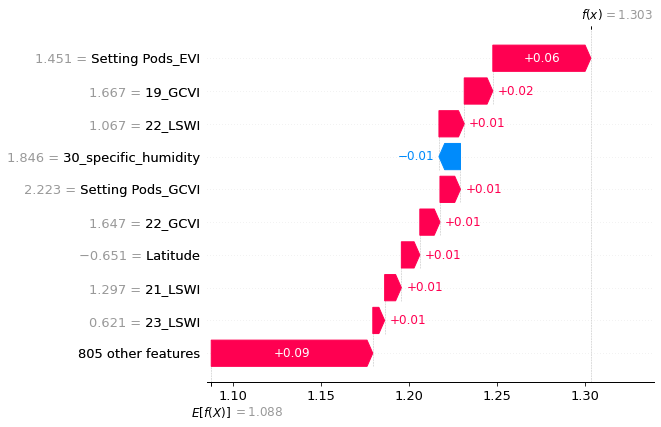

In [54]:
import matplotlib.pyplot as plt
plt.clf()
shap.plots.waterfall(shap_values[0],max_display=10,show=False)
plt.savefig('D:/论文-产量趋势利用/结果/特征排名/特征图/test.png',dpi=300, bbox_inches='tight')

croptype: soybean   test_year: 2014   experiment: NTP   training year: 10   trend_n： 30
----
Train_MAE: 0.0068
Train_MSE: 0.0002
Train_RMSE: 0.0130
Train_R2: 0.9995
----
Test_MAE: 0.2690
Test_MSE: 0.1115
Test_RMSE: 0.3340
Test_R2: 0.6285


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


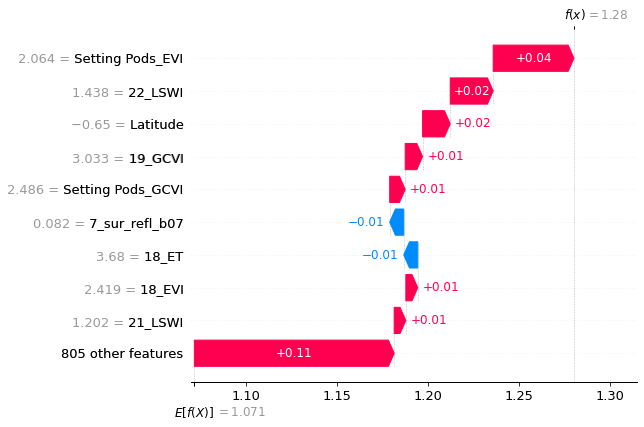

croptype: soybean   test_year: 2015   experiment: NTP   training year: 10   trend_n： 30
----
Train_MAE: 0.0069
Train_MSE: 0.0002
Train_RMSE: 0.0132
Train_R2: 0.9995
----
Test_MAE: 0.3470
Test_MSE: 0.1722
Test_RMSE: 0.4150
Test_R2: 0.4604


ntree_limit is deprecated, use `iteration_range` or model slicing instead.


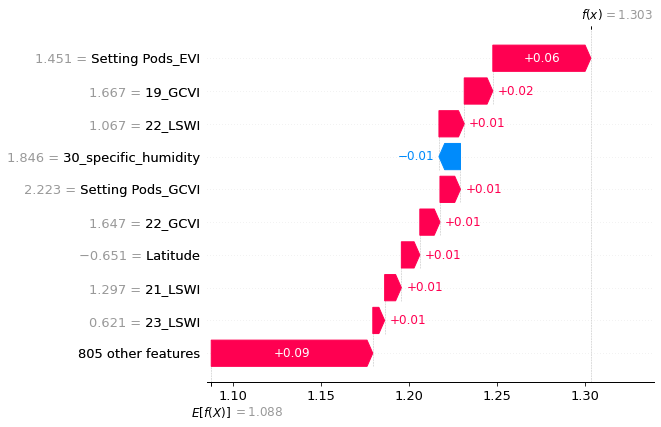

In [43]:
# 大豆
metric_list = []
for exp in ['NTP']: #, 'IYF', 'IAYF', 'ILYF', 'GDT']:
    for year in range(2014,2016):
        model,metric_list = yield_predictor(data,croptype = 'soybean', test_year = [year], N = 10, experiment = exp, model = ['XGBoost'],
                        verbose = 1, result = True, seed = 99, feature_importance  = False,metric_list = metric_list,feature_list = featurelist,
                        result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')
        name = ['seed', 'croptype', 'test_year', 'experiment', 'Train_years', 'trend_n', 'RMSE', 'R2']
metric_df = pd.DataFrame(columns = name,data=metric_list)
metric_df.to_csv('D:/论文-产量趋势利用/结果/' +'soybean' +'_预测指标.csv',header=True)


In [50]:
type(shap_values)

shap._explanation.Explanation

In [46]:
shap.initjs()
shap.plots.force(shap_values[0])

In [47]:
shap.plots.force(shap_values)

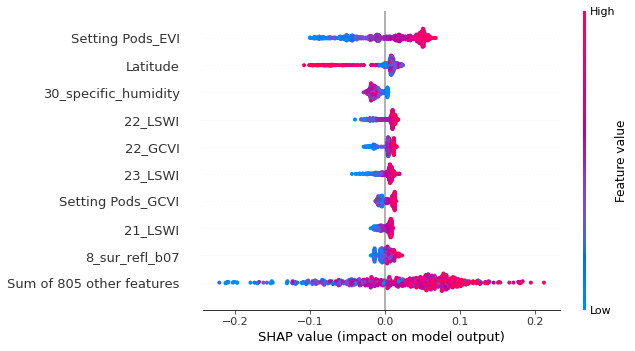

In [48]:
shap.plots.beeswarm(shap_values)

In [ ]:
# exp=4 测试年份 大豆 trend_n
for trend_n in range(2,35):
    for year in range(2014,2022):
        yield_predictor(data,croptype = 'soybean', test_year = [year], N = 10, experiment = 4,model = ['XGBoost'],
                        verbose = 0, result = False, seed = 99, feature_list  = featurelist,trend_n = trend_n)

In [154]:
# 玉米
data = read_data('D:/论文-产量趋势利用/数据/input_maize_exp.csv')
featurelist = read_data('D:/论文-产量趋势利用/结果/特征排名/maize/average feature importance.csv')
data.drop(columns = 'name',inplace = True)

In [ ]:
# exp=4 测试年份 玉米 trend_n
for trend_n in range(2,35):
    for year in range(2014,2022):
        yield_predictor(data,croptype = 'maize', test_year = [year], N = 10, experiment = 4,model = ['XGBoost'],
                        verbose = 0, result = False, seed = 99, feature_list  = featurelist,trend_n=trend_n)

In [ ]:
# 玉米
for exp in [0,1,2,3,4,20,30]:
    for year in range(2014,2022):
        yield_predictor(data,croptype = 'maize', test_year = [year], N = 10, experiment = exp,model = ['XGBoost'],
                        verbose = 1, result = True, seed = 99, feature_importance  = True,
                        result_dir = 'D:/论文-产量趋势利用/结果/预测结果/',
                        importance_dir= 'D:/论文-产量趋势利用/结果/特征排名/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，导出feature importance
for exp in [0,1,2,3,4,20,30]:
    for year in range(2014,2022):
        yield_predictor(data, test_year = [year], N = 10, experiment = exp,model = ['XGBoost'],verbose = 1,tune_model = False, 
                        model_parameter = model_parameter, result = False, seed = 99, feature_importance  = True,
                        importance_dir= 'D:/论文-产量趋势利用/结果/特征排名/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为0：不处理
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 0,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为1
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 1,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为2
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 2,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为3
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 3,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为4
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 4,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为20
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 20,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每10年预测一年，无调优，试验条件为30
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 30,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为0：不处理
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 0,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为1：输入年份
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 1,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为2：输入五年平均产量
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 2,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为3：输入30年线性趋势产量
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 3,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为4：30年整体去趋势
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 4,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为20：5年动态聚类平均产量
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 20,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 最终结果 2004-2021年，每5年预测一年，无调优，试验条件为30：30年动态聚类线性产量
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 30,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 2004-2021年，每5年预测一年，调优，试验条件为0
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 0,model = ['XGBoost'],verbose = 1,tune_model = True, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 2004-2021年，每5年预测一年，调优，试验条件为1
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 1,model = ['XGBoost'],verbose = 1,tune_model = True, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 2004-2021年，每5年预测一年，调优，试验条件为2
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 2,model = ['XGBoost'],verbose = 1,tune_model = True, 
                    model_parameter = model_parameter, result = True, seed = 99, result_dir = 'D:/论文-产量趋势利用/结果/预测结果/')

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为3（30年聚类趋势产量）
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 3,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = False, seed = 99)

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为7（分州去趋势）
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 5, experiment = 7,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = False, seed = 99)

In [ ]:
# 2004-2021年，每10年预测一年，调优，试验条件为2
for year in range(2014,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 2,model = ['XGBoost'],verbose = 1,tune_model = True, 
                    model_parameter = model_parameter, result = False, seed = 99)

In [ ]:
# 2004-2021年，每10年预测一年，无调优，试验条件为6，trend_n=30
for year in range(2009,2022):
    yield_predictor(data, test_year = [year], N = 10, experiment = 5,model = ['XGBoost'],verbose = 1,tune_model = False, 
                    model_parameter = model_parameter, result = False, seed = 99,trend_n = 30)

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为0
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 0,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为1
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 1,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为2
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 2,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

In [ ]:
# 2004-2021年，每5年预测一年，无调优，试验条件为3
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 3,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

In [48]:
# 2004-2021年，每5年预测一年，无调优，试验条件为4
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 4,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

soybean   4   5
2022-10-16 [2009] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.31, Test_R2: 0.64】
soybean   4   5
2022-10-16 [2010] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.29, Test_R2: 0.66】
soybean   4   5
2022-10-16 [2011] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.33, Test_R2: 0.68】
soybean   4   5
2022-10-16 [2012] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.47, Test_R2: 0.44】
soybean   4   5
2022-10-16 [2013] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.40, Test_R2: 0.56】
soybean   4   5
2022-10-16 [2014] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.32, Test_R2: 0.67】
soybean   4   5
2022-10-16 [2015] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.34, Test_R2: 0.64】
soybean   4   5
2022-10-16 [2016] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.46, Test_R2: 0.13】
soybean   4   5
2022-10-16 [2017] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.29, Test_R2: 0.74】
soybean   4   5
202

In [39]:
# 2004-2021年，每5年预测一年，无调优，试验条件为5
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 5,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.049×year + 2.866 - (-96.209)
2022-10-16 [2009] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.29, Test_R2: 0.67】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.062×year + 2.913 - (-121.290)
2022-10-16 [2010] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.27, Test_R2: 0.72】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.071×year + 2.947 - (-140.321)
2022-10-16 [2011] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.36, Test_R2: 0.63】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.073×year + 2.951 - (-143.896)
2022-10-16 [2012] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.43, Test_R2: 0.54】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.048×year + 2.912 - (-93.197)
2022-10-16 [2013] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.34, Test_R2: 0.69】
soybean   5   5
The foluma 

In [42]:
# 2004-2021年，每5年预测一年(10年去趋势)，无调优，试验条件为5
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 5,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

soybean   5   5
The foluma of de-trend the yield: yield_new = yield - -0.019×year + 2.866 - (41.137)
2022-10-16 [2009] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.35, Test_R2: 0.53】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - -0.007×year + 2.913 - (17.167)
2022-10-16 [2010] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.31, Test_R2: 0.63】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.042×year + 2.947 - (-80.699)
2022-10-16 [2011] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.33, Test_R2: 0.69】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - 0.057×year + 2.951 - (-111.250)
2022-10-16 [2012] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.45, Test_R2: 0.49】
soybean   5   5
The foluma of de-trend the yield: yield_new = yield - -0.006×year + 2.912 - (14.839)
2022-10-16 [2013] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.43, Test_R2: 0.49】
soybean   5   5
The foluma of

In [52]:
# 2004-2021年，每5年预测一年，无调优，试验条件为6
for year in range(2009,2022):
    yield_predictor(data, test_year=[year], N=5, experiment = 6,model=['XGBoost'],verbose=0,
                    tune_model=False, result=False, seed = 99)

soybean   6   5
2022-10-16 [2009] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.27, Test_R2: 0.71】
soybean   6   5
2022-10-16 [2010] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.32, Test_R2: 0.60】
soybean   6   5
2022-10-16 [2011] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.32, Test_R2: 0.71】
soybean   6   5
2022-10-16 [2012] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.46, Test_R2: 0.47】
soybean   6   5
2022-10-16 [2013] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.39, Test_R2: 0.58】
soybean   6   5
2022-10-16 [2014] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.33, Test_R2: 0.65】
soybean   6   5
2022-10-16 [2015] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.34, Test_R2: 0.64】
soybean   6   5
2022-10-16 [2016] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.47, Test_R2: 0.09】
soybean   6   5
2022-10-16 [2017] XGBoost 【Train_RMSE: 0.02, Train_R2: 1.00, Test_RMSE: 0.29, Test_R2: 0.76】
soybean   6   5
202

In [8]:
data

,Year,State,sta_con,yield(t/ha),7_NDVI,7_EVI,7_LSWI,7_GCVI,7_SAVI,7_ET,...,Setting Pods_temperature,Setting Pods_longwave_radiation,Setting Pods_ET,Dropping Leaves_temperature,Dropping Leaves_longwave_radiation,Dropping Leaves_ET,Harvested_temperature,Harvested_longwave_radiation,Harvested_ET,PIC
0,2004,illinois,illinois_de witt,3.62880,0.255448,0.149114,-0.130004,1.190226,0.159117,102.823865,...,67.285364,1123.066799,1148.995491,58.671282,1025.021911,339.967238,41.690183,929.544420,215.355876,0.030834
1,2004,illinois,illinois_logan,3.76320,0.248477,0.146820,-0.132477,1.167662,0.156487,102.929037,...,68.275422,1129.707828,1160.853118,59.726057,1031.220879,301.078202,42.587339,934.818602,199.654905,0.002965
2,2004,illinois,illinois_macon,3.69600,0.262322,0.152131,-0.137547,1.197579,0.160527,104.014208,...,67.965869,1129.354053,1137.223247,59.158023,1030.330289,277.818319,42.517888,936.455118,205.288996,0.030834
3,2004,illinois,illinois_marshall,3.56160,0.257644,0.140815,-0.131871,1.197946,0.151108,103.754759,...,67.722674,1126.297784,1164.081299,58.861114,1019.614572,371.009742,40.789112,919.018140,207.525084,0.009296
4,2004,illinois,illinois_mason,3.29280,0.277138,0.139093,-0.065738,1.283655,0.150517,96.300783,...,70.840804,1145.018082,1039.616281,60.482918,1031.466501,297.149532,43.066954,935.655051,202.305274,0.296371
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12114,2021,wisconsin,wisconsin_jackson,3.48768,0.323028,0.182592,0.056840,1.651254,0.197202,91.333333,...,68.999482,1096.908497,1173.944444,33.857043,647.134583,330.333333,40.182122,963.485910,230.333333,0.020266
12115,2021,wisconsin,wisconsin_monroe,3.15168,0.368797,0.205916,0.062353,1.924194,0.222491,90.000000,...,70.130898,1101.220057,1067.083333,35.766449,655.809640,310.750000,41.975157,970.288170,230.000000,0.008047
12116,2021,wisconsin,wisconsin_pepin,3.73632,0.339652,0.157176,0.005192,1.802343,0.172154,84.691057,...,74.723566,1128.920227,1063.138211,34.434346,650.760871,348.609756,41.318363,965.717747,223.764228,0.115911
12117,2021,wisconsin,wisconsin_pierce,3.74976,0.293496,0.152643,-0.002688,1.466855,0.165882,82.785534,...,75.201506,1127.651068,1080.521447,34.310423,649.207361,327.220774,40.752304,960.425419,208.640875,0.007217


In [178]:
data

,Year,State,sta_con,yield(t/ha),7_NDVI,7_EVI,7_LSWI,7_GCVI,7_SAVI,7_ET,...,State_kansas,State_michigan,State_minnesota,State_missouri,State_nebraska,State_north dakota,State_ohio,State_south dakota,State_wisconsin,average yield
0,2004,illinois,illinois_de witt,11.352141,0.249488,0.144578,-0.134570,1.158571,0.154178,104.520954,...,0,0,0,0,0,0,0,0,0,NaN
1,2004,illinois,illinois_logan,11.791174,0.253670,0.152310,-0.121809,1.191329,0.162124,102.111885,...,0,0,0,0,0,0,0,0,0,1.0
2,2004,illinois,illinois_macon,11.979331,0.262964,0.152108,-0.141542,1.193544,0.159980,105.751238,...,0,0,0,0,0,0,0,0,0,NaN
3,2004,illinois,illinois_marshall,11.477579,0.271255,0.146165,-0.117543,1.262208,0.156941,104.749029,...,0,0,0,0,0,0,0,0,0,NaN
4,2004,illinois,illinois_mason,11.226703,0.284259,0.146599,-0.047472,1.318735,0.158019,96.491758,...,0,0,0,0,0,0,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12440,2021,wisconsin,wisconsin_la crosse,10.806486,0.333321,0.190578,0.028164,1.699896,0.205009,88.000000,...,0,0,0,0,0,0,0,0,1,NaN
12441,2021,wisconsin,wisconsin_monroe,9.175791,0.375168,0.210972,0.058332,1.959579,0.226691,88.110193,...,0,0,0,0,0,0,0,0,1,NaN
12442,2021,wisconsin,wisconsin_pepin,11.088721,0.309651,0.158052,-0.005151,1.578534,0.172392,84.584482,...,0,0,0,0,0,0,0,0,1,NaN
12443,2021,wisconsin,wisconsin_pierce,11.659464,0.296960,0.153793,0.003512,1.499968,0.167324,83.180400,...,0,0,0,0,0,0,0,0,1,NaN


In [175]:
data.loc[(data['Year']==2004) & (data['sta_con']=='illinois_logan'),'average yield']

1   NaN
Name: average yield, dtype: float64

In [176]:
data

,Year,State,sta_con,yield(t/ha),7_NDVI,7_EVI,7_LSWI,7_GCVI,7_SAVI,7_ET,...,State_kansas,State_michigan,State_minnesota,State_missouri,State_nebraska,State_north dakota,State_ohio,State_south dakota,State_wisconsin,average yield
0,2004,illinois,illinois_de witt,11.352141,0.249488,0.144578,-0.134570,1.158571,0.154178,104.520954,...,0,0,0,0,0,0,0,0,0,NaN
1,2004,illinois,illinois_logan,11.791174,0.253670,0.152310,-0.121809,1.191329,0.162124,102.111885,...,0,0,0,0,0,0,0,0,0,NaN
2,2004,illinois,illinois_macon,11.979331,0.262964,0.152108,-0.141542,1.193544,0.159980,105.751238,...,0,0,0,0,0,0,0,0,0,NaN
3,2004,illinois,illinois_marshall,11.477579,0.271255,0.146165,-0.117543,1.262208,0.156941,104.749029,...,0,0,0,0,0,0,0,0,0,NaN
4,2004,illinois,illinois_mason,11.226703,0.284259,0.146599,-0.047472,1.318735,0.158019,96.491758,...,0,0,0,0,0,0,0,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12440,2021,wisconsin,wisconsin_la crosse,10.806486,0.333321,0.190578,0.028164,1.699896,0.205009,88.000000,...,0,0,0,0,0,0,0,0,1,NaN
12441,2021,wisconsin,wisconsin_monroe,9.175791,0.375168,0.210972,0.058332,1.959579,0.226691,88.110193,...,0,0,0,0,0,0,0,0,1,NaN
12442,2021,wisconsin,wisconsin_pepin,11.088721,0.309651,0.158052,-0.005151,1.578534,0.172392,84.584482,...,0,0,0,0,0,0,0,0,1,NaN
12443,2021,wisconsin,wisconsin_pierce,11.659464,0.296960,0.153793,0.003512,1.499968,0.167324,83.180400,...,0,0,0,0,0,0,0,0,1,NaN
